In [1]:
gdrive = False

try :
    from google.colab import drive
    
    drive.mount('/content/gdrive')
    
    gdrive = True
    
except :
    print('Not GDrive')

Not GDrive


In [2]:
!pip install pydot

import sys

if sys.platform == 'Linux' :
    !apt-get install graphviz
else :
    print("Install GraphViz manually")

Install GraphViz manually


In [3]:
import math

import numpy as np

import matplotlib.pyplot as plt

from PIL import Image

In [4]:
import tensorflow as tf

from tensorflow import keras


from keras import backend as K

from keras.utils import plot_model

from keras.utils.vis_utils import model_to_dot

Using TensorFlow backend.


In [5]:
import pydot

import IPython

In [6]:
import os, glob

In [7]:
from include.json2labelImg import json2labelImg

from include.labels import labels

In [8]:
%matplotlib inline

# Load Dataset

#### Initialization of Paths to the Dataset/Output Data

In [9]:
if gdrive :
  path_to_dataset = os.path.join(os.path.dirname(os.path.abspath('__file__')), 'gdrive', 'My Drive', 'G Suite Account', 'Datasets', 'CityScapes')
else :
  path_to_dataset = os.path.join(os.path.dirname(os.path.abspath('__file__')), '..', '..', '..', 'Datasets', 'CityScapes')

In [10]:
if gdrive :
  output_data_path = os.path.join(os.path.dirname(os.path.abspath('__file__')), 'gdrive', 'My Drive', 'Colab Notebooks', 'output')
else :
  output_data_path = os.path.join(os.path.dirname(os.path.abspath('__file__')), 'output')

In [11]:
path = os.path.join(path_to_dataset, 'leftImg8bit_trainvaltest', 'leftImg8bit')


train_images_path = os.path.join(path, 'train')

val_images_path =  os.path.join(path, 'val')

test_images_path =  os.path.join(path, 'test')

In [12]:
path = os.path.join(path_to_dataset, 'gtFine_trainvaltest', 'gtFine')


train_labels_path =  os.path.join(path, 'train')

val_labels_path =  os.path.join(path, 'val')

test_labels_path =  os.path.join(path, 'test')

#### Functions

In [13]:
def retrieve_image(file_path) :
    return np.asarray(Image.open(file_path))

In [14]:
def retrieve_label(file_path) :
    return np.asarray(json2labelImg(file_path, encoding = 'ids'))

In [15]:
def retrieve_downscaled_image(file_path, factor = 4) :
    image = Image.open(file_path)
    
    size = np.int32(np.divide(image.size, factor))
    
    rescaled_image = np.asarray(image.resize(size = size, resample = Image.LANCZOS))
    
    return rescaled_image
    #return np.vstack((rescaled_image, np.uint8(np.zeros((7, rescaled_image.shape[1], rescaled_image.shape[2])))))

In [16]:
def CustomPooling(image, kernel = (2, 2), stride = 2) :
    output_width = int((image.size[0] - kernel[0]) / stride + 1)
    output_height = int((image.size[1] - kernel[1]) / stride + 1)
    
    return image.resize(size = (output_width, output_height), resample = Image.NEAREST)

In [17]:
def retrieve_downscaled_label(file_path, factor = 4) :
    image = json2labelImg(file_path, encoding = 'ids')
    
    rescaled_image = np.asarray(CustomPooling(image, (factor, factor), factor))
    
    return rescaled_image

### Training Data

#### Images

In [18]:
# List all Images

search_path = os.path.join(train_images_path, '*', '*.png')

train_images_files = glob.glob(search_path)
train_images_files.sort()

In [19]:
train_images = []

for file in train_images_files[0:10] :
    train_images.append(retrieve_downscaled_image(file))

train_images = np.array(train_images)

#### Labels

In [20]:
#List all Label Files

search_path = os.path.join(train_labels_path, '*', '*_polygons.json')

train_labels_files = glob.glob(search_path)
train_labels_files.sort()

In [21]:
train_labels = []

for file in train_labels_files[0:10] :
    train_labels.append(retrieve_downscaled_label(file))

train_labels = np.array(train_labels)

### Validation Data

#### Images

In [22]:
# List all Images

search_path = os.path.join(val_images_path, '*', '*.png')

val_images_files = glob.glob(search_path)
val_images_files.sort()

In [23]:
val_images = []

for file in val_images_files[0:10] :
    val_images.append(retrieve_downscaled_image(file))

val_images = np.array(val_images)

#### Labels

In [24]:
#List all Label Files

search_path = os.path.join(val_labels_path, '*', '*_polygons.json')

val_labels_files = glob.glob(search_path)
val_labels_files.sort()

In [25]:
val_labels = []

for file in val_labels_files[0:10] :
    val_labels.append(retrieve_downscaled_label(file))

val_labels = np.array(val_labels)

### Test Data

#### Images

In [26]:
# List all Images

search_path = os.path.join(test_images_path, '*', '*.png')

test_images_files = glob.glob(search_path)
test_images_files.sort()

In [27]:
test_images = []

for file in test_images_files[0:10] :
    test_images.append(retrieve_downscaled_image(file))

test_images = np.array(test_images)

#### Labels

In [28]:
#List all Label Files

search_path = os.path.join(test_labels_path, '*', '*_polygons.json')

test_labels_files = glob.glob(search_path)
test_labels_files.sort()

In [29]:
test_labels = []

for file in test_labels_files[0:10] :
    test_labels.append(np.asarray(retrieve_downscaled_label(file)))

test_labels = np.array(test_labels)

### One-Hot Encode the Labels

In [30]:
output_channels = train_labels.max() - train_labels.min() + 1

print('Output Channels: ' + str(output_channels))

Output Channels: 34


In [31]:
def one_hot_encode(label_image, channels) :
    image_one_hot = np.zeros(label_image.shape + (channels,))
    
    a = np.arange(label_image.shape[0]).reshape(label_image.shape[0], 1)
    b = np.tile(np.arange(label_image.shape[1]), (label_image.shape[0], 1))
    
    image_one_hot[a, b, label_image] = 1
    
    return np.asarray(image_one_hot)

#### Encode

In [32]:
train_labels_one_hot = []

for label in train_labels :
    train_labels_one_hot.append(one_hot_encode(label, output_channels))

train_labels_one_hot = np.array(train_labels_one_hot)

print(train_labels_one_hot.shape)

(10, 256, 512, 34)


In [33]:
val_labels_one_hot = []

for label in val_labels :
    val_labels_one_hot.append(one_hot_encode(label, output_channels))

val_labels_one_hot = np.array(val_labels_one_hot)

print(val_labels_one_hot.shape)

(10, 256, 512, 34)


In [34]:
test_labels_one_hot = []

for label in test_labels :
    test_labels_one_hot.append(one_hot_encode(label, output_channels))

test_labels_one_hot = np.array(test_labels_one_hot)

print(test_labels_one_hot.shape)

(10, 256, 512, 34)


In [35]:
print(train_images[0].shape)

(256, 512, 3)


### Visualization

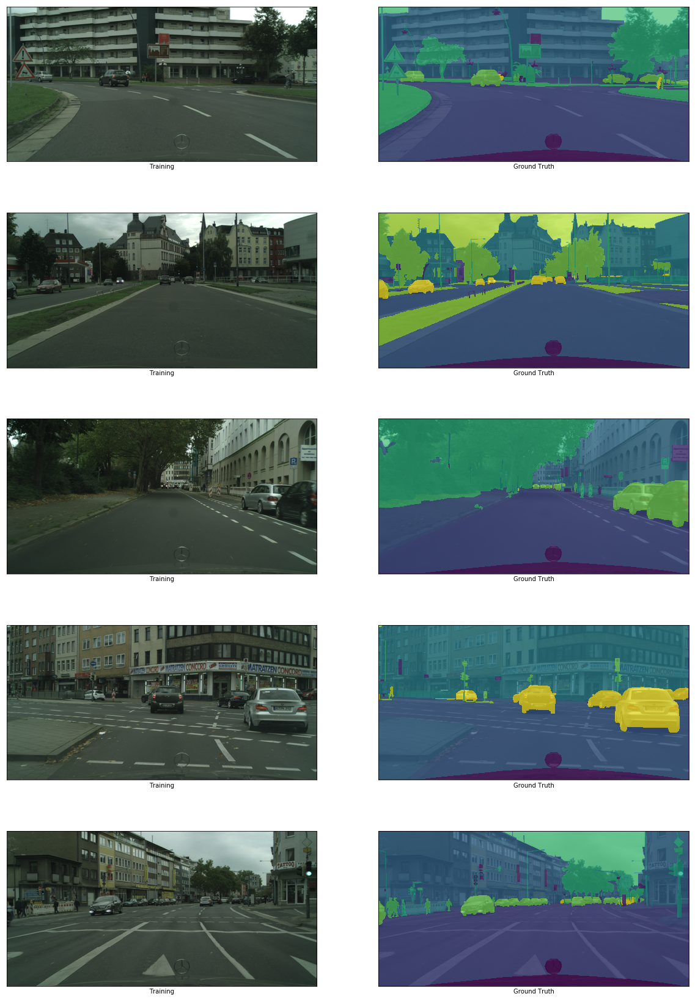

In [36]:
plt.figure(figsize = (20, 30))

k = 0

for i in range(5) :
    for j in range(1) :
        plt.subplot(5, 2, (k * 2) + 1)
        
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        
        plt.imshow(train_images[k])
        plt.xlabel('Training')
        
        plt.subplot(5, 2, (k * 2) + 2)
        
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        
        plt.imshow(train_images[k])
        plt.imshow(train_labels[k], alpha = 0.7)
        plt.xlabel('Ground Truth')
        
        k += 1

### Model & Training

In [37]:
input_shape_t = (None, None, train_images[0].shape[2])

input_shape_t = train_images[0].shape

In [38]:
# Data Generator (Input: Images)

def image_data_generator(inputs, labels) :
    i = 0
    
    while True:
        input = np.array([inputs[i % len(inputs)]])
        label = np.array([one_hot_encode(labels[i % len(inputs)], output_channels)])
        
        yield input, label
        
        i+=1

In [39]:
# Data Generator (Input: File names)

def file_data_generator(inputs, labels) :
    i = 0
    
    while True:
        input = np.asarray([retrieve_downscaled_image(inputs[i % len(inputs)])])
        label = np.asarray([one_hot_encode(retrieve_downscaled_label(labels[i % len(inputs)]), output_channels)])
        
        yield input, label
        
        i+=1

In [40]:
def UpSampling2DBilinear(size):
    return keras.layers.Lambda(lambda x: tf.image.resize_bilinear(x, size, align_corners=True))

In [41]:
a, b = next(file_data_generator(train_images_files, train_labels_files))

print(a.shape)
print(b.shape)

(1, 256, 512, 3)
(1, 256, 512, 34)


In [42]:
if 'model' in locals():
    del model

In [43]:
model_input = keras.layers.Input(shape = input_shape_t)

conv1 = keras.layers.Conv2D(64, kernel_size = (10, 5), padding = 'same', input_shape = input_shape_t, activation = 'relu')(model_input)
pool1 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2)(conv1)

conv2 = keras.layers.Conv2D(128, kernel_size = (10, 5), padding = 'same', activation = 'relu', input_shape = input_shape_t)(pool1)
pool2 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2)(conv2)

conv3 = keras.layers.Conv2D(256, kernel_size = (10, 5), padding = 'same', activation = 'relu')(pool2)
pool3 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2)(conv3)

conv4 = keras.layers.Conv2D(256, kernel_size = (14, 7), padding = 'same', activation = 'relu')(pool3)
pool4 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2)(conv4)

conv5 = keras.layers.Conv2D(512, kernel_size = (14, 7), padding = 'same', activation = 'relu')(pool4)

deconv1 = keras.layers.Conv2DTranspose(512, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu')(conv5)

deconv2 = keras.layers.Conv2DTranspose(512, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu')(deconv1)

deconv3 = keras.layers.Conv2DTranspose(256, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu')(deconv2)

deconv4 = keras.layers.Conv2DTranspose(256, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu')(deconv3)

#drop1 = keras.layers.Dropout(0.5)(deconv3)

#endupsample1 = keras.layers.UpSampling2D(size = (4, 4))(conv2)

endconv1 = keras.layers.Conv2D(output_channels, kernel_size = (1, 1), padding = 'same', activation = 'softmax')(deconv4)

In [44]:
model_input = keras.layers.Input(shape = input_shape_t, name = 'Input_Layer')

conv1 = keras.layers.Conv2D(128, kernel_size = (6, 3), padding = 'same', activation = 'relu', name = 'Convolution1-128-6x3')(model_input)
pool1 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2, name = 'MaxPooling1-2x2-2')(conv1)

conv2 = keras.layers.Conv2D(256, kernel_size = (6, 3), padding = 'same', activation = 'relu', name = 'Convolution2-256-6x3')(pool1)
pool2 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2, name = 'MaxPooling2-2x2-2')(conv2)

conv3 = keras.layers.Conv2D(256, kernel_size = (6, 3), padding = 'same', activation = 'relu', name = 'Convolution3-256-6x3')(pool2)
pool3 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2, name = 'MaxPooling3-2x2-2')(conv3)

conv4 = keras.layers.Conv2D(512, kernel_size = (6, 3), padding = 'same', activation = 'relu', name = 'Convolution4-512-6x3')(pool3)
pool4 = keras.layers.MaxPooling2D(pool_size = (2, 2), strides = 2, name = 'MaxPooling4-2x2-2')(conv4)

conv5 = keras.layers.Conv2D(512, kernel_size = (6, 3), padding = 'same', activation = 'relu', name = 'Convolution5-512-6x3')(pool4)

add1 = keras.layers.Add(name = 'Add1_Conv5_Pool4')([conv5, pool4])

deconv1 = keras.layers.Conv2DTranspose(256, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu', name = 'Deconvolution1-256-2x2-2')(add1)

add2 = keras.layers.Add(name = 'Add1_DeConv1_Pool3')([deconv1, pool3])

deconv2 = keras.layers.Conv2DTranspose(256, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu', name = 'Deconvolution2-256-2x2-2')(add2)

add3 = keras.layers.Add(name = 'Add1_DeConv2_Pool2')([deconv2, pool2])

deconv3 = keras.layers.Conv2DTranspose(128, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu', name = 'Deconvolution3-128-2x2-2')(add3)

add4 = keras.layers.Add(name = 'Add1_DeConv3_Pool1')([deconv3, pool1])

deconv4 = keras.layers.Conv2DTranspose(128, kernel_size = (2, 2), strides = 2, padding = 'valid', activation = 'relu', name = 'Deconvolution4-128-2x2-2')(add4)

drop1 = keras.layers.Dropout(0.5, name = 'Dropout-0.5')(deconv4)

#endupsample1 = keras.layers.UpSampling2D(size = (4, 4))(conv2)

endconv1 = keras.layers.Conv2D(output_channels, kernel_size = (1, 1), padding = 'same', activation = 'softmax', name = 'Final_Convolution-' + str(output_channels) + '-1x1')(drop1)

In [0]:
model = keras.models.Model(inputs = model_input, outputs = endconv1)

In [46]:
model.compile(optimizer = tf.train.AdamOptimizer(), loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [47]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           (None, None, None, 3 0                                            
__________________________________________________________________________________________________
conv2d_66 (Conv2D)              (None, None, None, 1 7040        input_15[0][0]                   
__________________________________________________________________________________________________
max_pooling2d_41 (MaxPooling2D) (None, None, None, 1 0           conv2d_66[0][0]                  
__________________________________________________________________________________________________
conv2d_67 (Conv2D)              (None, None, None, 2 590080      max_pooling2d_41[0][0]           
__________________________________________________________________________________________________
max_poolin

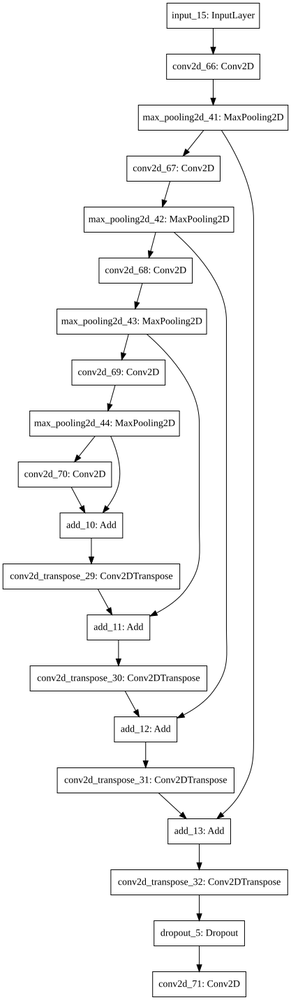

In [41]:
# Save & Display the model structure as an SVG

plot_model(model, to_file = os.path.join(output_data_path, 'model.png'))

#model_img = plt.imread(os.path.join(output_data_path, 'model.png'))

#plt.figure(figsize = (20, 40))
#plt.imshow(model_img)


# Save & Display the model structure as an SVG

svg = model_to_dot(model).create(prog='dot', format='svg')

with open(os.path.join(output_data_path, 'model-svg.svg'), 'wb') as file :
    file.write(svg)

IPython.display.SVG(svg)

In [0]:
tensorboard_callback = keras.callbacks.TensorBoard(log_dir = os.path.join(output_data_path, 'Tensorboard_logs'), histogram_freq = 0, batch_size = 32, write_graph = True, write_grads = True, write_images = True)

In [0]:
model.fit_generator(file_data_generator(train_images_files, train_labels_files), steps_per_epoch = len(train_images_files[0:10]), epochs = 1)

#model.fit_generator(file_data_generator(train_images_files, train_labels_files), steps_per_epoch = len(train_images_files), epochs = 2, callbacks = [tensorboard_callback])

Epoch 1/1
10/10 [==============================] - 14s 1s/step - loss: 2.6813 - acc: 0.3211


In [48]:
def predict_output(image, model = model) :
    predict = model.predict(np.array([image]))
    
    predict = np.argmax(predict, axis = 3)[0]
    
    return predict

In [49]:
def category_color(predict) :
    predict = [[labels[pixel].color for pixel in row] for row in predict]
    
    return predict

In [77]:
print(np.unique(label, True))
print(np.unique(predict, True))

(array([0, 1, 3], dtype=uint8), array([   513, 108315,      0], dtype=int64))
(array([ 1,  3,  7,  8, 11, 12, 17, 20, 21, 22, 23, 24, 26, 31],
      dtype=int64), array([108315,      0,  33252,  33251,    513,  61444,   2234,  38080,
         2505,  58051,    641,  33248,  33275,  34809], dtype=int64))


(256, 512, 3)


Text(0.5,0,'Accuracy: 0.7771224975585938')

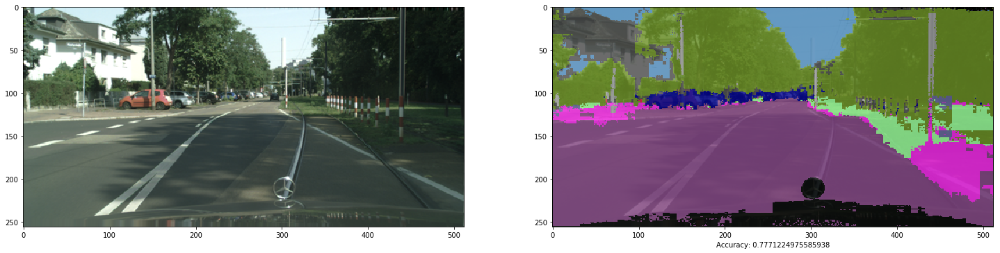

In [51]:
image = retrieve_downscaled_image(val_images_files[10])
label = retrieve_downscaled_label(val_labels_files[10])

#image = retrieve_downscaled_image('1.jpg')


predict = predict_output(image)

accuracy = np.sum(predict == label) / (label.shape[0] * label.shape[1])
predict = category_color(predict)

print(image.shape)

plt.figure(figsize = (25, 8))

plt.subplot(1, 2, 1)
plt.imshow(image)

plt.subplot(1, 2, 2)
plt.imshow(image)
plt.imshow(predict, alpha = 0.8)
plt.xlabel('Accuracy: ' + str(accuracy))

#plt.savefig(os.path.join(output_data_path, 'results-cityscapes.png'))

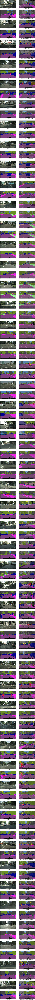

In [58]:
plt.figure(figsize = (15, 450))

for i in range(50) :
    image = retrieve_downscaled_image(val_images_files[i])
    label = retrieve_downscaled_label(val_labels_files[i])
    
    
    predict = predict_output(image)
    
    accuracy = np.sum(predict == label) / (label.shape[0] * label.shape[1])
    
    label = category_color(label)
    predict = category_color(predict)
    
    
    plt.subplot(100, 2, (i * 4) + 1)
    
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.imshow(image)
    plt.xlabel('(' + str(i) + '): Test Image')
    
    
    plt.subplot(100, 2, (i * 4) + 2)
        
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.imshow(image)
    plt.imshow(label, alpha = 0.7)
    plt.xlabel('(' + str(i) + '): Test Image + Ground Truth' )
    
    
    plt.subplot(100, 2, (i * 4) + 3)
    
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.imshow(predict)
    plt.xlabel('(' + str(i) + '): Prediction')
    
    
    plt.subplot(100, 2, (i * 4) + 4)
    
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.imshow(image)
    plt.imshow(predict, alpha = 0.7)
    
    plt.xlabel('(' + str(i) + '): Test Image + Prediction accuracy (' + str(accuracy) + '%)')

In [0]:
test_loss, test_accuracy = model.evaluate_generator(file_data_generator(val_images_files, val_labels_files), steps = len(val_images_files))#, use_multiprocessing = True)

print('Accuracy: ', test_accuracy)
print('Test Loss: ', test_loss)

Accuracy:  0.7863334655761719
Test Loss:  0.9364687611162662


# Visualize Model

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

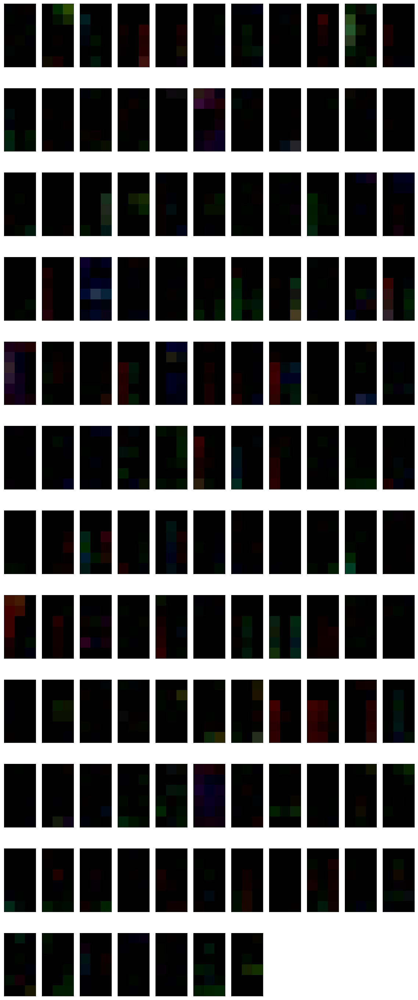

In [52]:
model_weights = model.get_weights()

first_layer_weights = model_weights[0]
first_layer_weights = np.transpose(first_layer_weights, (3, 0, 1, 2))

x = math.ceil(math.sqrt(len(first_layer_weights)))
y = math.ceil(len(first_layer_weights) / x)

plt.figure(figsize = (20, 50))

for i, channel_weights in enumerate(first_layer_weights) :
    plt.subplot(x, y, i+1)
    
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    
    plt.imshow(channel_weights)
    
    #print(channel_weights)
    
    #break

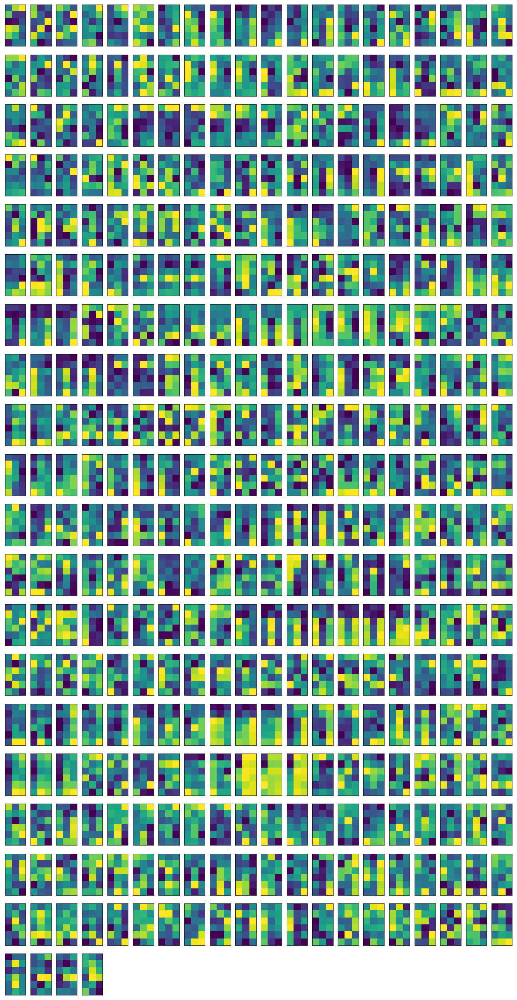

In [55]:
model_weights = model.get_weights()


for layer_weights in model_weights :
    
    if len(layer_weights.shape) == 4 :
        
        layer_weights = np.transpose(layer_weights, (3, 2, 0, 1))
        
        n = 1
        
        t = layer_weights.shape[0] * layer_weights.shape[1]
        x = math.ceil(math.sqrt(t))
        y = math.ceil(t / x)
        
        plt.figure(figsize = (20, 40))
        
        for i, channel_weights in enumerate(layer_weights) :
            
            for j, sub_channel_weights in enumerate(channel_weights) :
                
                plt.subplot(x, y, n)
                plt.xticks([])
                plt.yticks([])
                plt.imshow(sub_channel_weights)
                
                n = n + 1
        
        plt.show()
    
    else :
        
        continue
    
    
    break


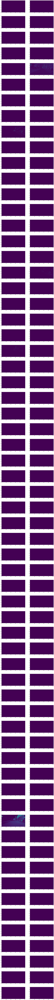

In [96]:
input_image = retrieve_downscaled_image(train_images_files[2])

for i, layer in enumerate(model.layers[5:], 1) :
    test_model = keras.models.Model(inputs = model.input, outputs = model.layers[i].output)
    
    outputs = test_model.predict(np.array([input_image]))[0]
    outputs = np.transpose(outputs, (2, 0, 1))
    plt.figure(figsize = (20, 400))
    
    for j, output in enumerate(outputs[0:128]) :
        plt.subplot(int(len(outputs)/2)+1, 2, j+1)
        plt.imshow(output)
    
    break

# Save/Load Model

In [0]:
# Save Model

model_json = model.to_json()

with open(os.path.join(output_data_path, 'model - Cityscapes'), 'w') as file :
    file.write(model_json)

model.save_weights(os.path.join(output_data_path, 'weights - Cityscapes.h5'))

In [45]:
# Load Model

with open(os.path.join(output_data_path, 'model - Cityscapes'), 'r') as file :
    model = keras.models.model_from_json(file.read())

model.load_weights(os.path.join(output_data_path, 'weights - Cityscapes.h5'))

### Save/Load Model History

In [35]:
import pickle

In [0]:
# Save Model History

with open((os.path.join(output_data_path, 'model_history - Cityscapes'), 'wb') as file :
    pickle.dump(model_history.history, file)

In [37]:
# Load Model History

with open(os.path.join(output_data_path, 'model_history - Cityscapes'), 'rb') as file :
    model_history_t = pickle.load(file)

model_history = keras.callbacks.History
model_history.history = model_history_t

FileNotFoundError: [Errno 2] No such file or directory: 'G:\\Machine Learning\\TensorFlow\\Semantic Segmentation\\Cityscapes\\Cityscapes_Data\\model_history - Cityscapes'